In [39]:
%matplotlib inline
import matplotlib.pyplot as plt
from glob import glob
from PIL import Image
import numpy as np
import torch
from transformers import CLIPProcessor, CLIPModel
import cv2
import os
import json
import yaml

In [40]:
def objectDetection(img_path:str, model) -> list:
    image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
    image_name = os.path.basename(img_path)
    image_name = image_name.split('.')[0]

    result = model(image)
    result.crop(save_dir=os.path.join("YOLO", image_name))
    detectedObjects = result.render()[0]
    path = os.path.join("YOLO", image_name, 'crops', '**', '*.jpg')

    listOfObjects = []
    for filename in glob(path):
        obj = cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB)
        listOfObjects.append(obj)     

    return listOfObjects, detectedObjects

In [41]:
def similarity_top(similarity_list:list, listOfObjects:list, N) -> tuple():
    results = zip(range(len(similarity_list)), similarity_list)
    results = sorted(results, key=lambda x: x[1], reverse=True)
    images = []
    scores=[]
    scores2=[]
    for index, score in results[:N]:
        scores.append(score)
        images.append(listOfObjects[index])

    return scores, images


def findObjects(listOfObjects:list, query:list, model, preprocess, device:str, N) -> tuple():
    similarity=[]

    for i in listOfObjects:
        objects = preprocess(text=query, images=Image.fromarray(i), return_tensors="pt", padding=True)

        outputs = model(**objects)
        logits_per_image = outputs.logits_per_image
        # logits_per_image = logits_per_image.softmax(dim=1)
        similarity.append(logits_per_image[0][0].item()+logits_per_image[0][1].item())

    scores, images = similarity_top(similarity, listOfObjects, N=N)

    for i in range(5):
        print(str(scores[i]))
        
    return scores, images

In [42]:
def plotResults(scores:list, images:list, n):
    plt.figure(figsize=(20,5))
    for index, img in enumerate(images):
        if (index<n):
            plt.subplot(1,n, index+1)
            plt.imshow(img)
            plt.title(scores[index])
            plt.axis('off')
    plt.show()

In [43]:
with open('ObjectDetection.yaml', 'r') as config_file:
    config = yaml.safe_load(config_file)

OBJDETECTIONMODEL = config['object_detection_config']['model']
OBJDETECTIONREPO = config['object_detection_config']['repository']

objectDetectorModel = torch.hub.load(OBJDETECTIONREPO, OBJDETECTIONMODEL)

requirements: Ultralytics requirement ['matplotlib>=3.3'] not found, attempting AutoUpdate...


Using cache found in C:\Users\prath/.cache\torch\hub\ultralytics_yolov5_master



requirements: AutoUpdate success ✅ 5.7s, installed 1 package: ['matplotlib>=3.3']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



YOLOv5  2024-2-8 Python-3.9.18 torch-2.1.2+cpu CPU

Fusing layers... 
YOLOv5x6 summary: 574 layers, 140730220 parameters, 0 gradients, 209.6 GFLOPs
Adding AutoShape... 


In [44]:
DEVICE = 'cpu'
N = 5

In [45]:
objectFinderModel = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
preProcess = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

In [46]:
def pipeline(video_path, prompt1, prompt2):
    data={}
    cap = cv2.VideoCapture(video_path)

    output_dir = 'FootageFrames'
    os.makedirs(output_dir, exist_ok=True)

    frame_count = 0
    fps = cap.get(cv2.CAP_PROP_FPS)

    output_file = 'result_data.json'
        
    while cap.isOpened():
        ret, frame = cap.read()
        
        if not ret:
            break
        
        timestamp_seconds = frame_count / fps
        
        if frame_count % int(fps) == 0:
            frame_file = os.path.join(output_dir, f'frame_{frame_count}.jpg')
            cv2.imwrite(frame_file, frame)

            listOfObjects, detectedObjects = objectDetection(frame_file, objectDetectorModel)
            scores, images = findObjects(listOfObjects, [prompt1,prompt2], objectFinderModel, preProcess, DEVICE, N)

            correctImg=0

            for i in scores:
                if i>46:
                    correctImg+=1

            if correctImg > 0:
                data['timestamp'] = timestamp_seconds
                data['Number of detected objects'] = correctImg

                with open(output_file, 'a') as f:  # Open JSON file in append mode here
                    json.dump(data, f, indent=4)

            plt.figure(figsize=(20,5))
            plt.axis('off')
            plt.imshow(detectedObjects)
            plotResults(scores, images, correctImg)

        frame_count += 1

    # Release the capture and close all windows
    cap.release()
    cv2.destroyAllWindows()

Saved 1 image to YOLO\frame_0
Saved results to YOLO\frame_0



47.42757606506348
46.135040283203125
44.191354751586914
44.17856979370117
43.7175407409668


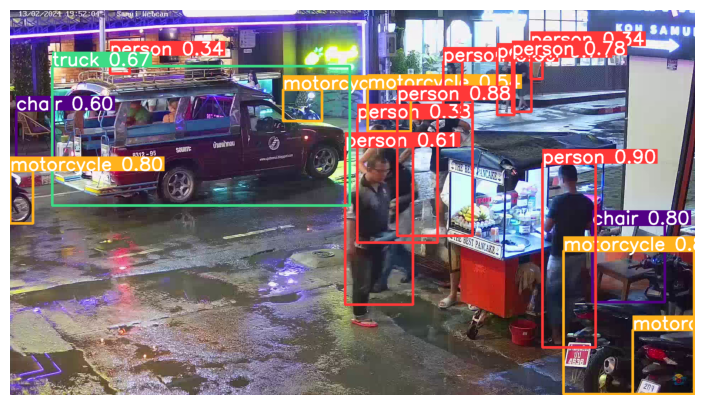

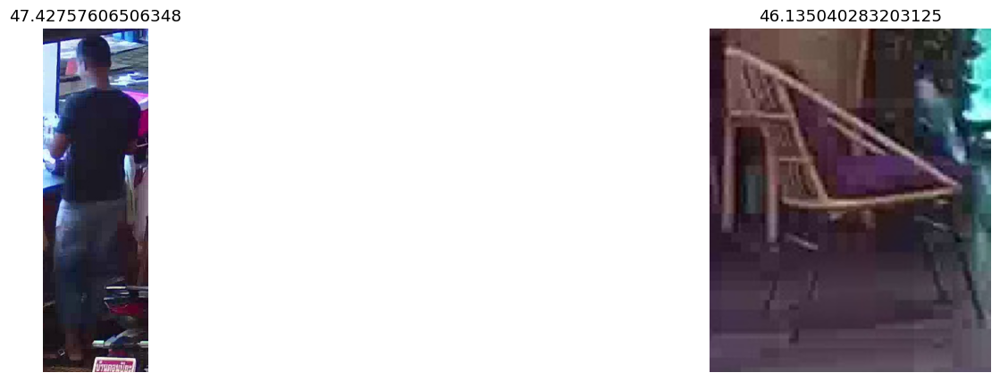

Saved 1 image to YOLO\frame_60
Saved results to YOLO\frame_60



47.42131996154785
46.93802261352539
44.77799415588379
44.71731185913086
43.55154609680176


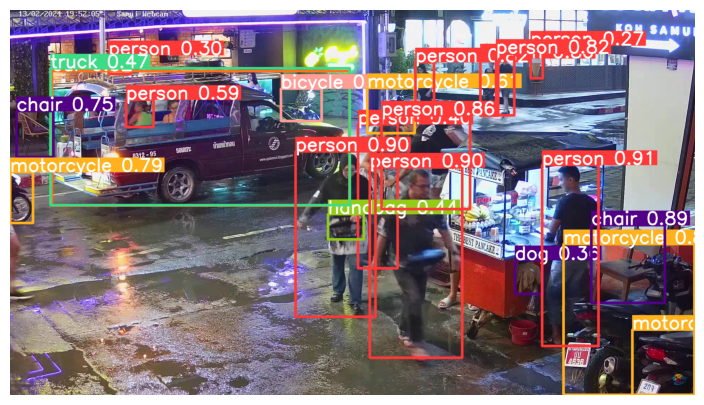

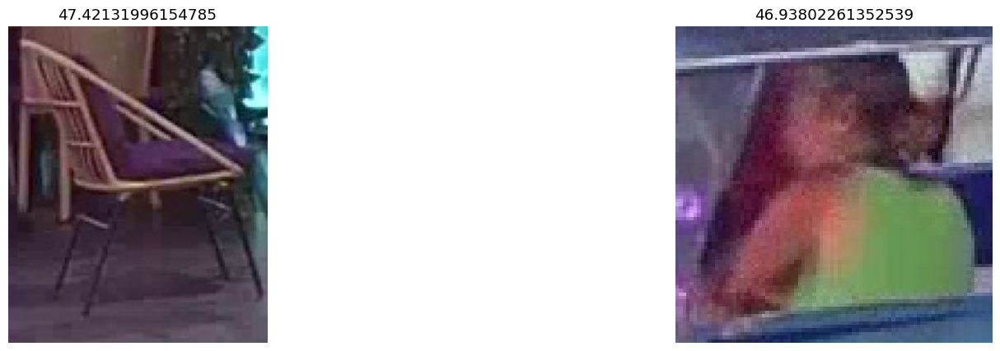

Saved 1 image to YOLO\frame_120
Saved results to YOLO\frame_120



46.73370361328125
44.043113708496094
44.021663665771484
43.76979064941406
43.53238868713379


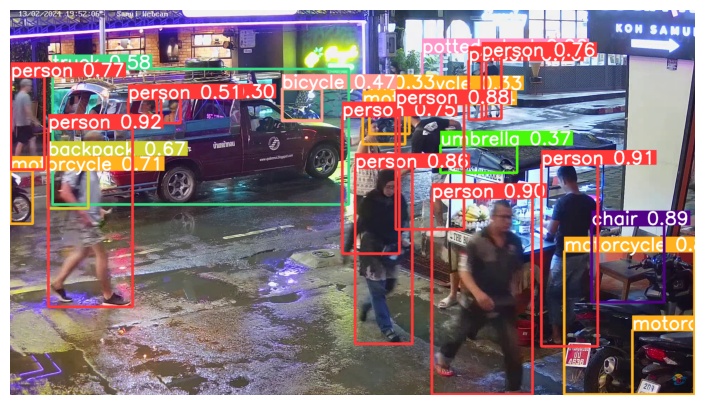

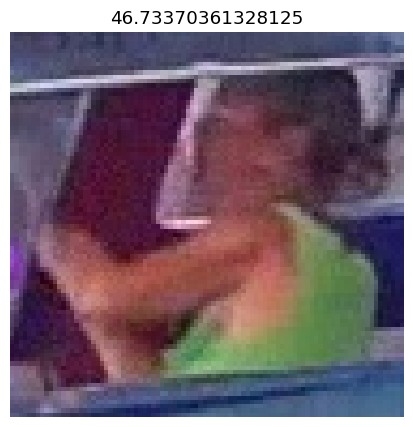

Saved 1 image to YOLO\frame_180
Saved results to YOLO\frame_180



49.04928970336914
47.780303955078125
46.104400634765625
44.56633758544922
44.13417625427246


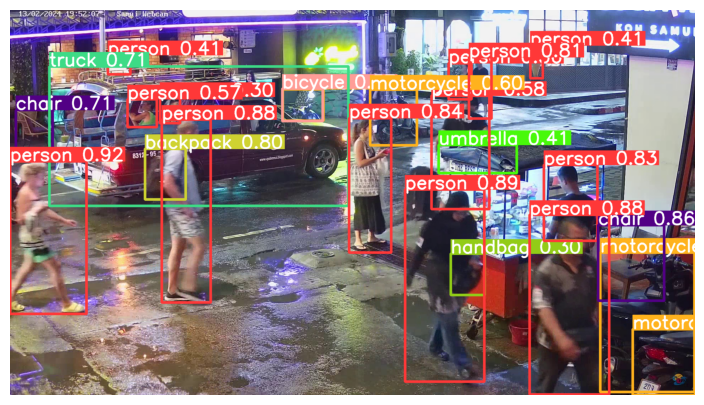

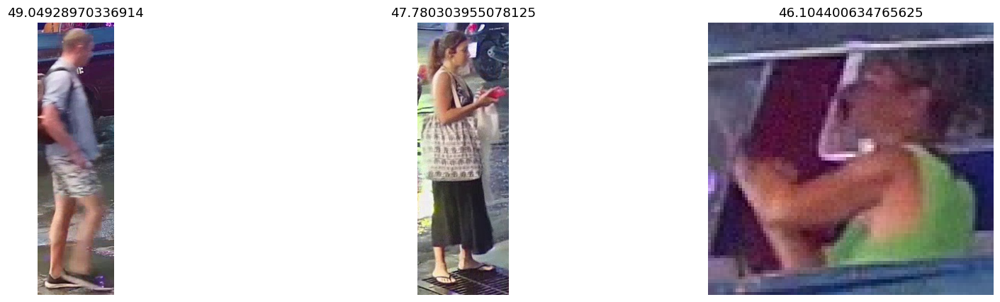

Saved 1 image to YOLO\frame_240
Saved results to YOLO\frame_240



52.43986701965332
46.171213150024414
46.07086944580078
46.01329040527344
45.11430549621582


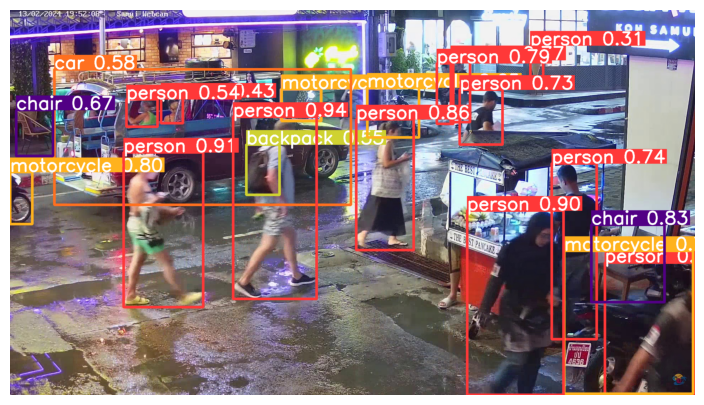

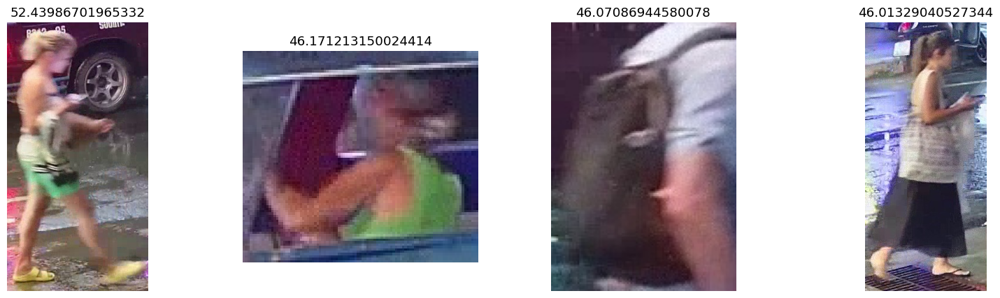

Saved 1 image to YOLO\frame_300
Saved results to YOLO\frame_300



45.98134803771973
45.62848663330078
45.57604789733887
45.35550498962402
44.75256156921387


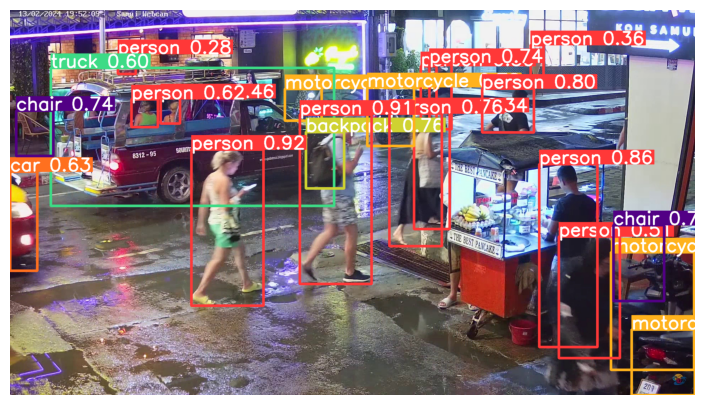

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_360
Saved results to YOLO\frame_360



47.689069747924805
46.63885688781738
45.88467216491699
45.380897521972656
43.955379486083984


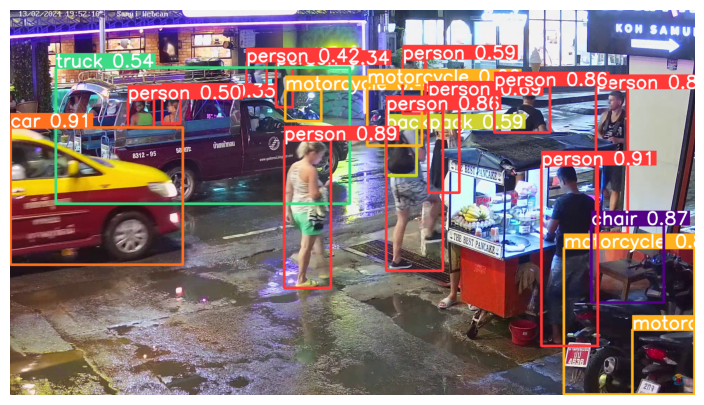

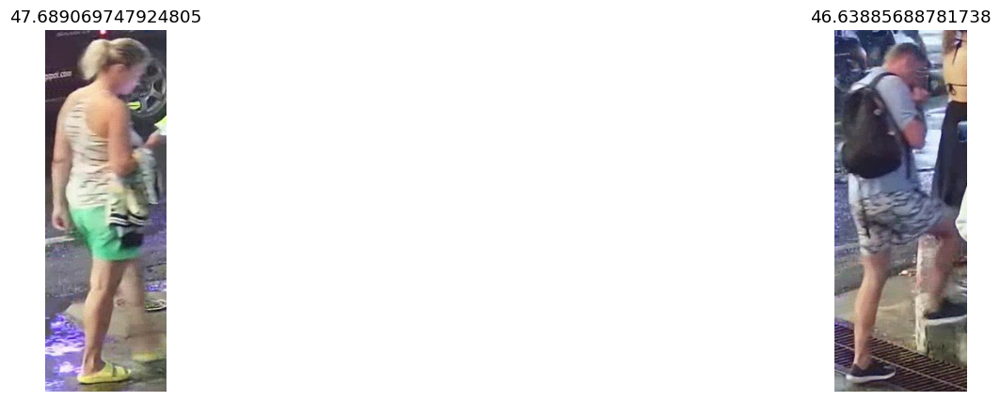

Saved 1 image to YOLO\frame_420
Saved results to YOLO\frame_420



46.17758750915527
45.56577491760254
44.887996673583984
44.17029571533203
43.86725044250488


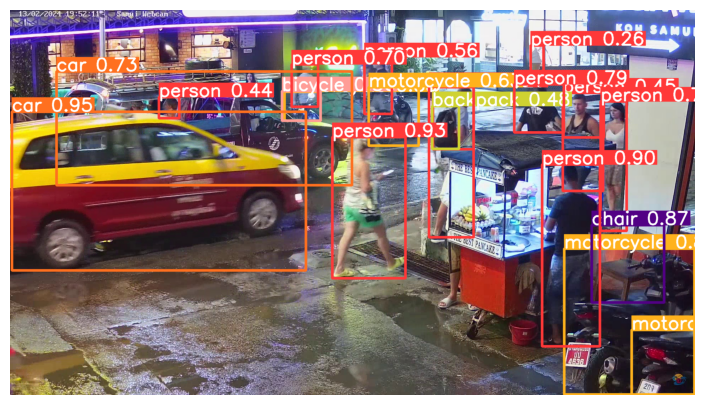

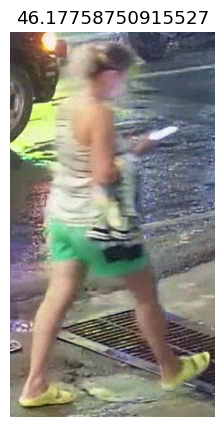

Saved 1 image to YOLO\frame_480
Saved results to YOLO\frame_480



51.142133712768555
45.06070327758789
44.667890548706055
44.08654022216797
42.68508529663086


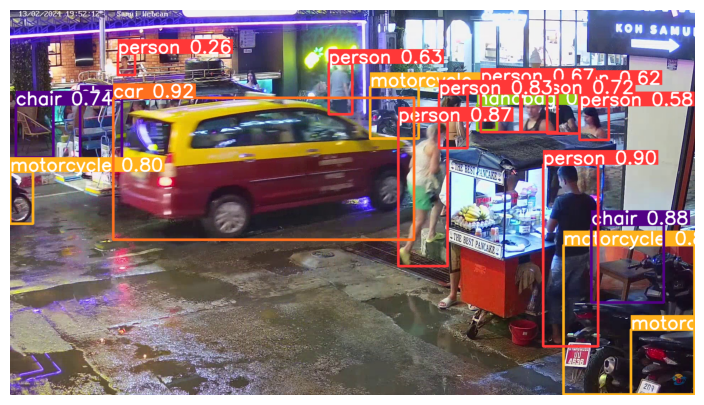

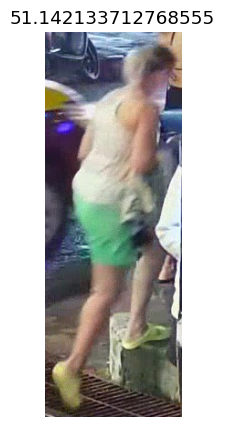

Saved 1 image to YOLO\frame_540
Saved results to YOLO\frame_540



44.66499710083008
44.39581298828125
43.86217498779297
43.30535888671875
43.2916374206543


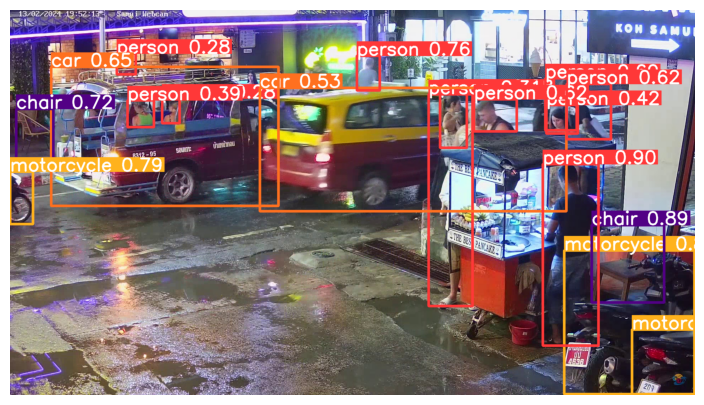

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_600
Saved results to YOLO\frame_600



46.03139686584473
44.93527030944824
44.67815399169922
44.48054885864258
43.86943435668945


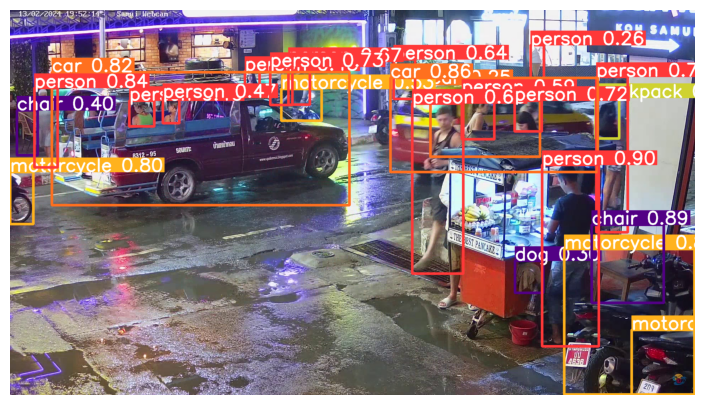

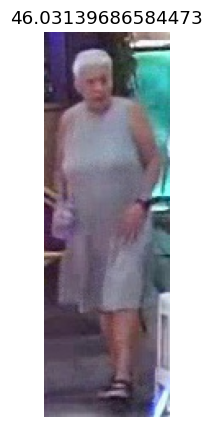

Saved 1 image to YOLO\frame_660
Saved results to YOLO\frame_660



48.82844352722168
46.24544906616211
45.042118072509766
44.49497604370117
44.26419258117676


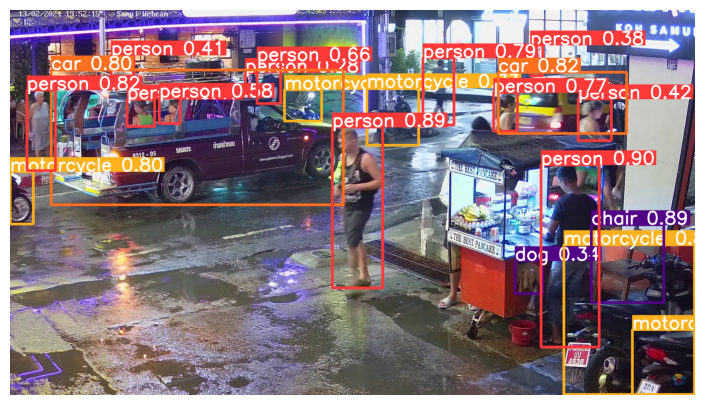

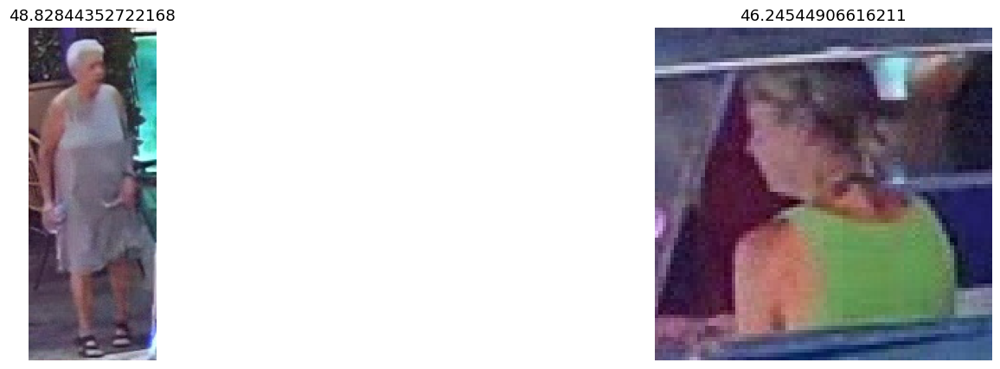

Saved 1 image to YOLO\frame_720
Saved results to YOLO\frame_720



47.67582893371582
45.70135307312012
45.406761169433594
44.79080009460449
43.62568664550781


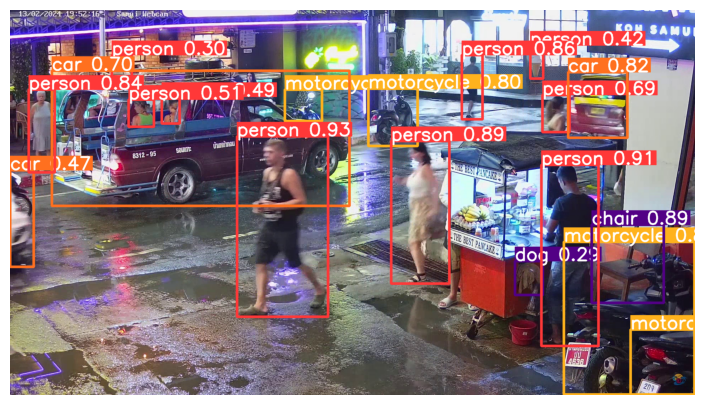

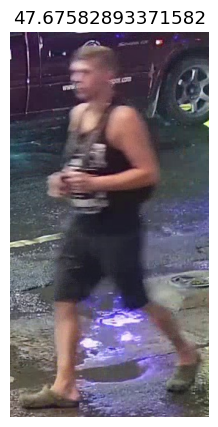

Saved 1 image to YOLO\frame_780
Saved results to YOLO\frame_780



47.68731689453125
46.88421440124512
45.106454849243164
45.06589317321777
44.70716857910156


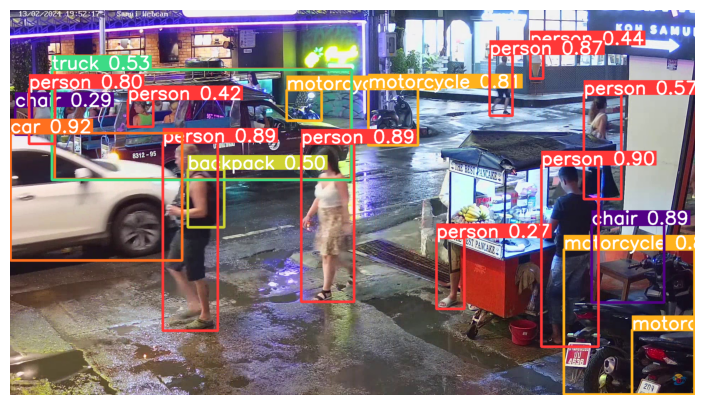

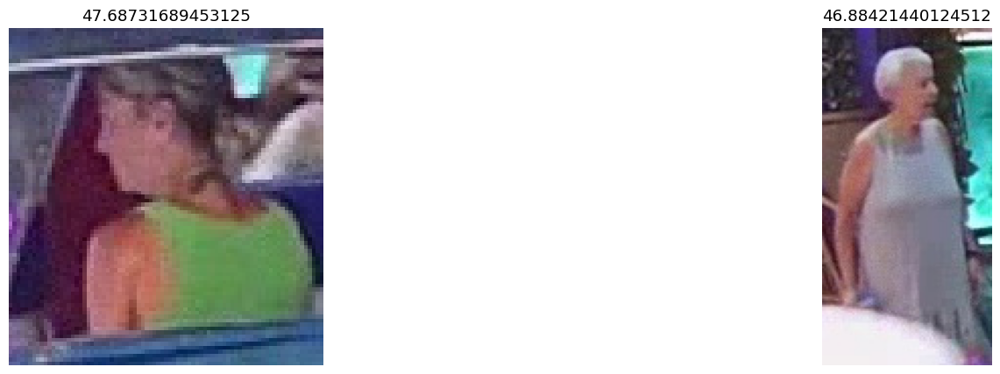

Saved 1 image to YOLO\frame_840
Saved results to YOLO\frame_840



48.940664291381836
47.9322566986084
46.33793067932129
45.5450325012207
44.71232795715332


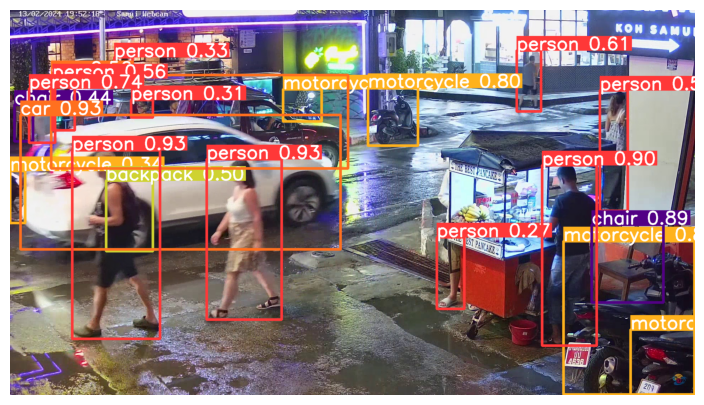

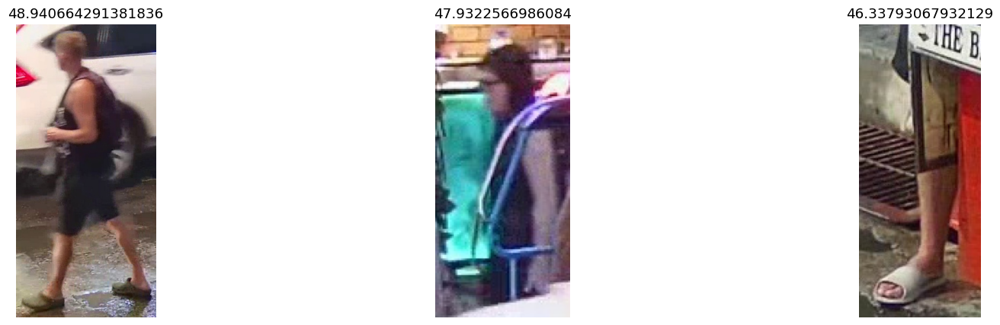

Saved 1 image to YOLO\frame_900
Saved results to YOLO\frame_900



47.15383720397949
45.69783401489258
45.46648597717285
45.25676918029785
45.23323059082031


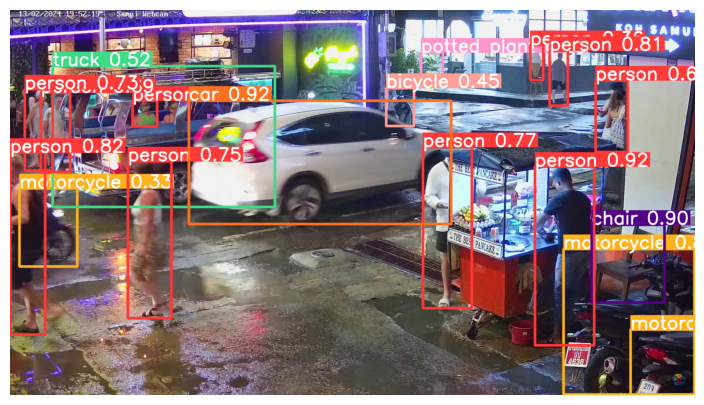

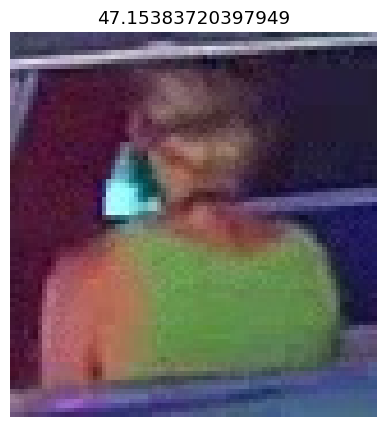

Saved 1 image to YOLO\frame_960
Saved results to YOLO\frame_960



46.372270584106445
44.59049034118652
44.38673973083496
43.35993194580078
43.04663276672363


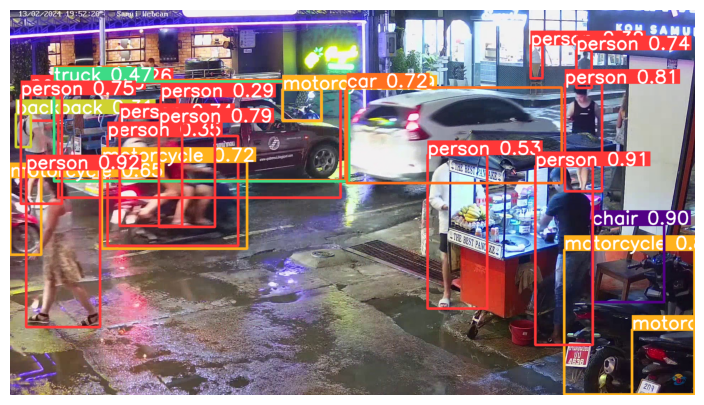

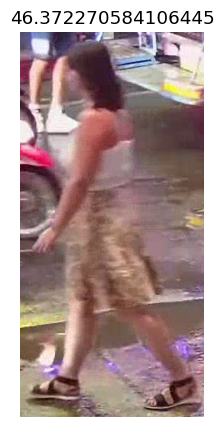

Saved 1 image to YOLO\frame_1020
Saved results to YOLO\frame_1020



44.76833724975586
44.64938545227051
44.51910591125488
43.03029251098633
42.31092834472656


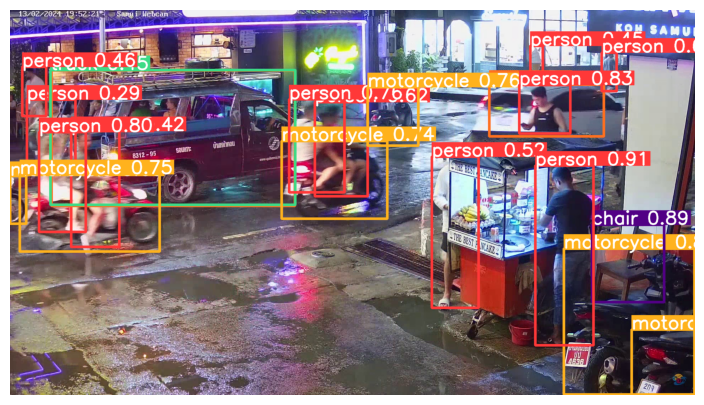

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_1080
Saved results to YOLO\frame_1080



45.80779266357422
45.05291175842285
42.927059173583984
42.557945251464844
42.52596855163574


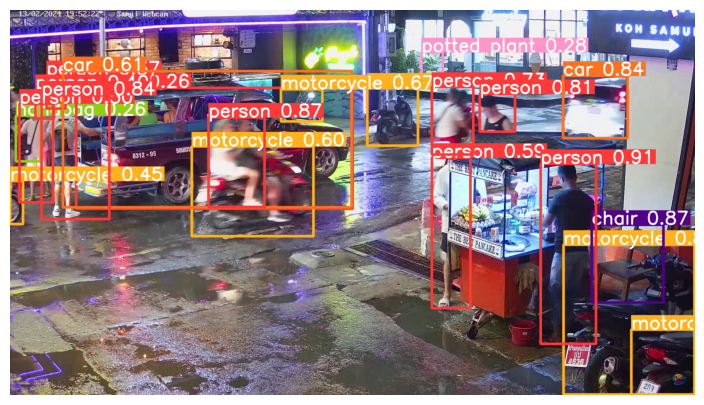

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_1140
Saved results to YOLO\frame_1140



47.93385314941406
45.91093063354492
44.56979751586914
44.248226165771484
43.49680137634277


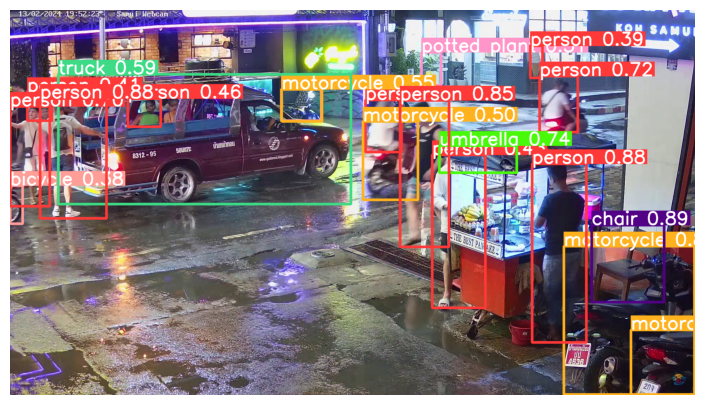

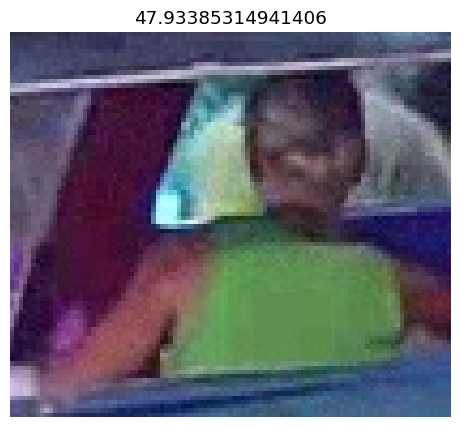

Saved 1 image to YOLO\frame_1200
Saved results to YOLO\frame_1200



46.3872013092041
45.251190185546875
42.910898208618164
42.23964500427246
41.46795463562012


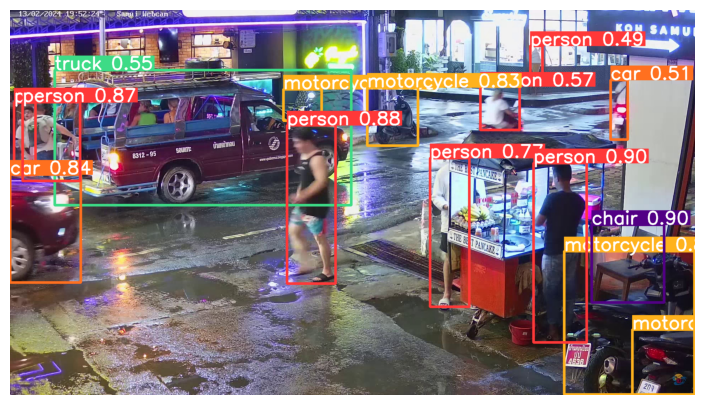

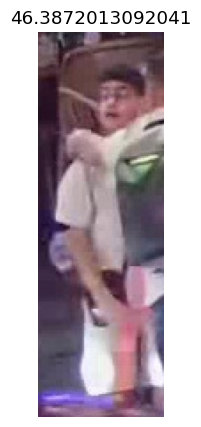

In [47]:
pipeline("footage2.mp4","woman","green shorts")

Saved 1 image to YOLO\frame_02
Saved results to YOLO\frame_02



44.793230056762695
44.475303649902344
44.196218490600586
42.76060104370117
42.71781349182129


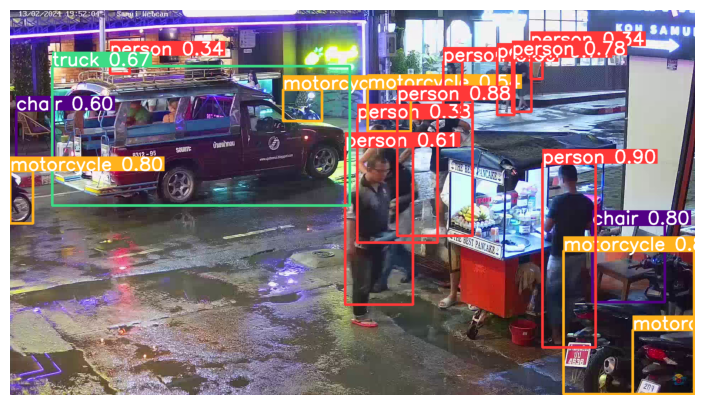

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_602
Saved results to YOLO\frame_602



46.4158821105957
46.00524139404297
43.62338638305664
42.74640655517578
41.41475486755371


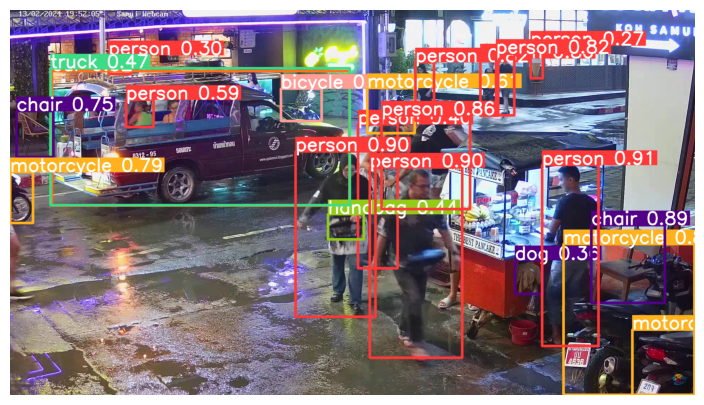

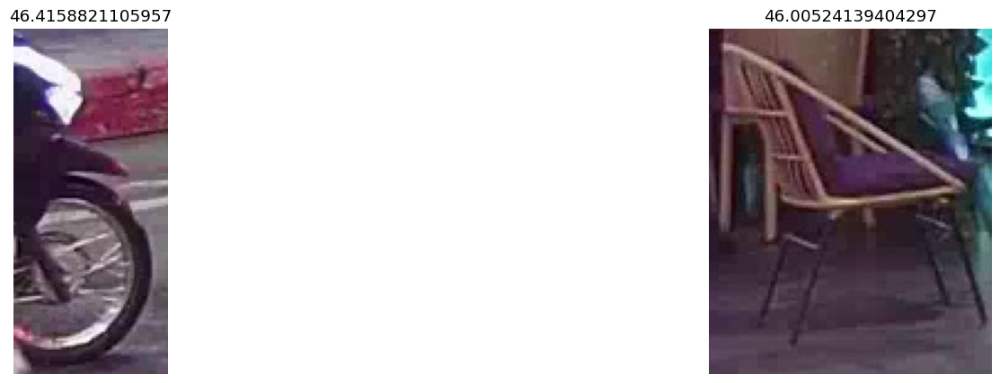

Saved 1 image to YOLO\frame_1202
Saved results to YOLO\frame_1202



44.87823677062988
43.58561897277832
42.91200828552246
42.60430145263672
42.21516990661621


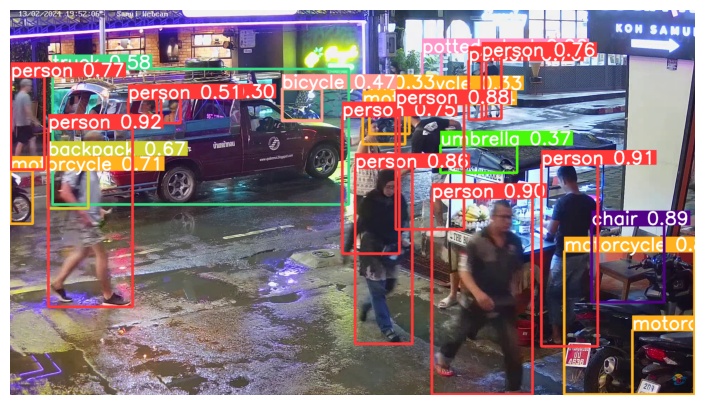

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_1802
Saved results to YOLO\frame_1802



47.04129409790039
43.408491134643555
43.37425994873047
42.104440689086914
41.84235382080078


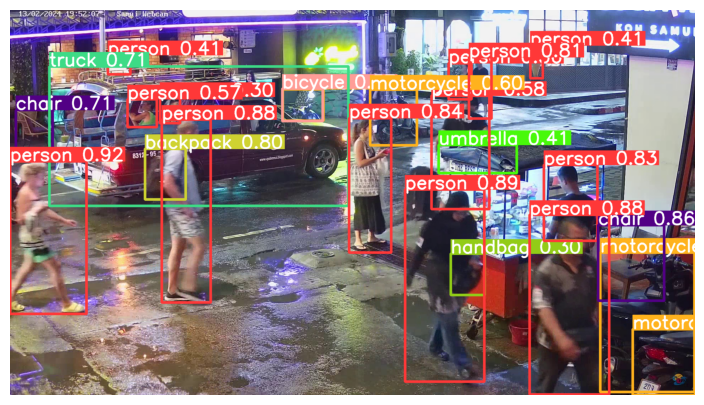

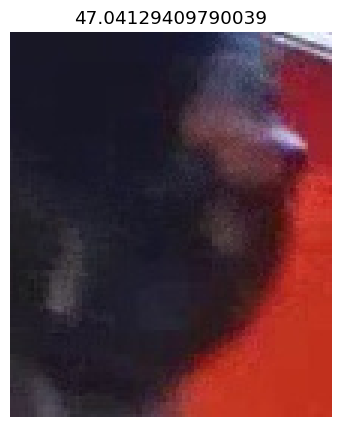

Saved 1 image to YOLO\frame_2402
Saved results to YOLO\frame_2402



47.225318908691406
45.235158920288086
45.007476806640625
44.014564514160156
42.86309242248535


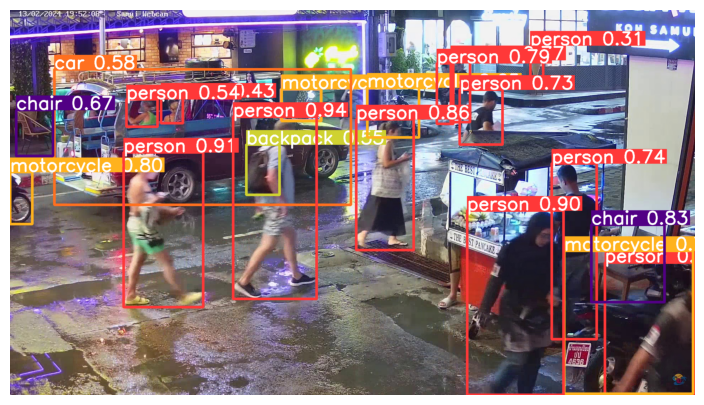

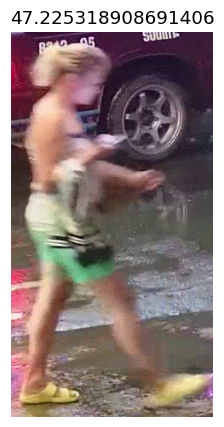

Saved 1 image to YOLO\frame_3002
Saved results to YOLO\frame_3002



45.782297134399414
44.09732437133789
41.96116065979004
41.49469566345215
41.08717346191406


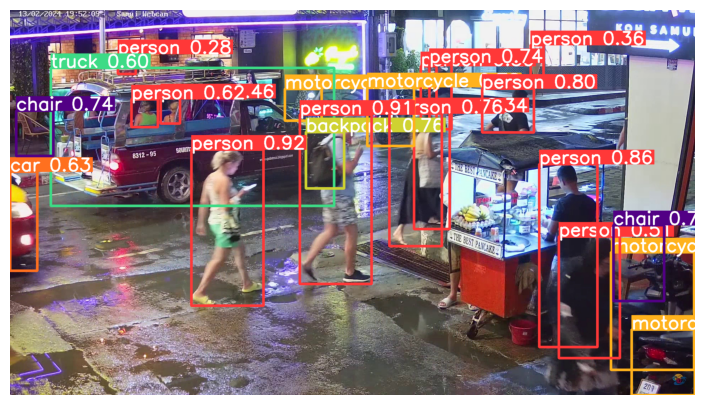

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_3602
Saved results to YOLO\frame_3602



44.916748046875
43.67141532897949
42.0101203918457
41.726579666137695
41.702253341674805


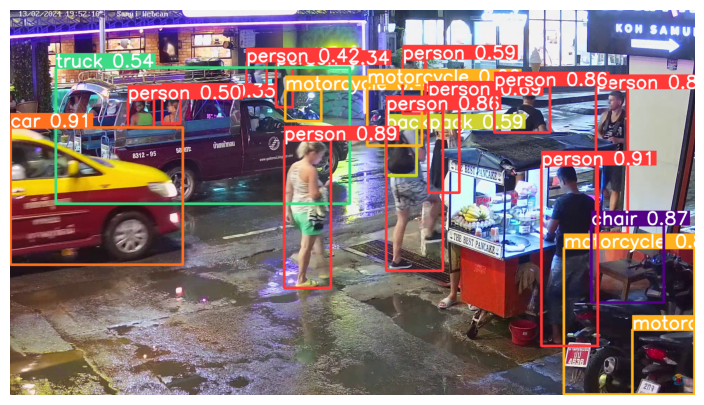

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_4202
Saved results to YOLO\frame_4202



48.69058799743652
47.15607261657715
44.975990295410156
41.75205421447754
41.73516082763672


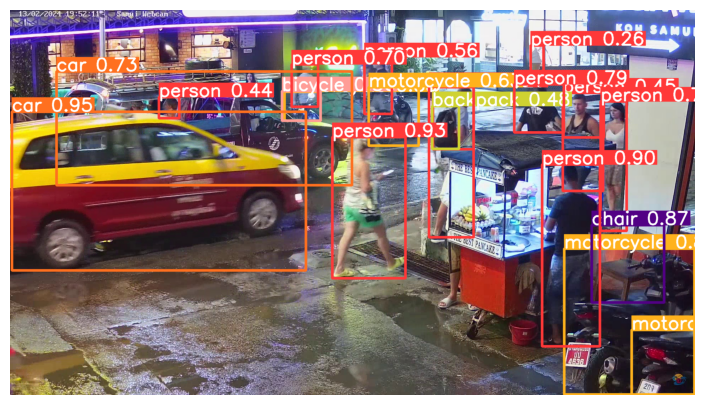

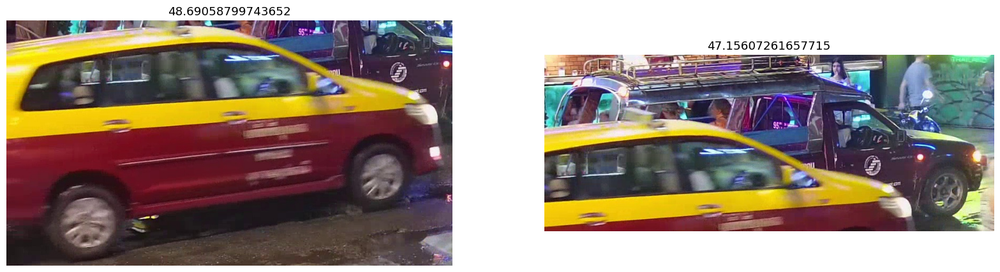

Saved 1 image to YOLO\frame_4802
Saved results to YOLO\frame_4802



51.21157264709473
43.397687911987305
42.33590126037598
42.29333305358887
41.4703254699707


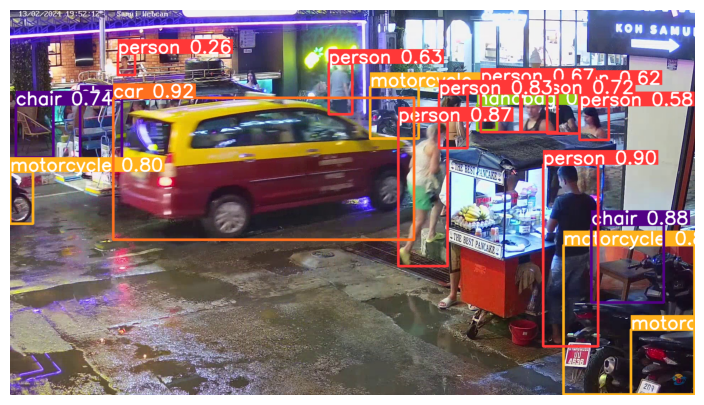

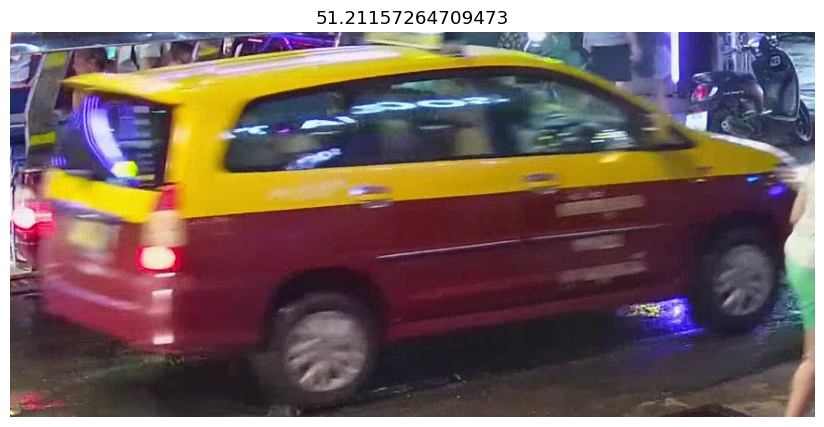

Saved 1 image to YOLO\frame_5402
Saved results to YOLO\frame_5402



46.66596221923828
46.02189254760742
42.194265365600586
42.12693405151367
41.31247138977051


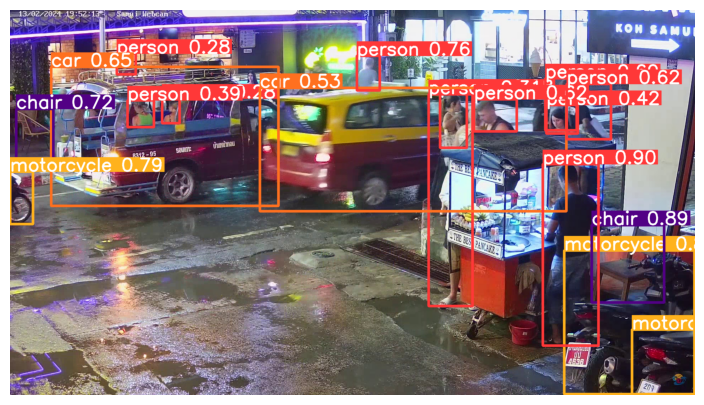

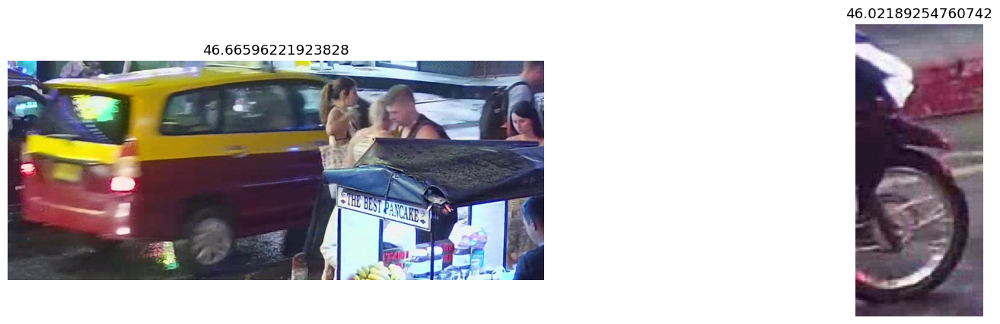

Saved 1 image to YOLO\frame_6002
Saved results to YOLO\frame_6002



48.92473220825195
45.93403434753418
44.31463050842285
43.183807373046875
42.09156036376953


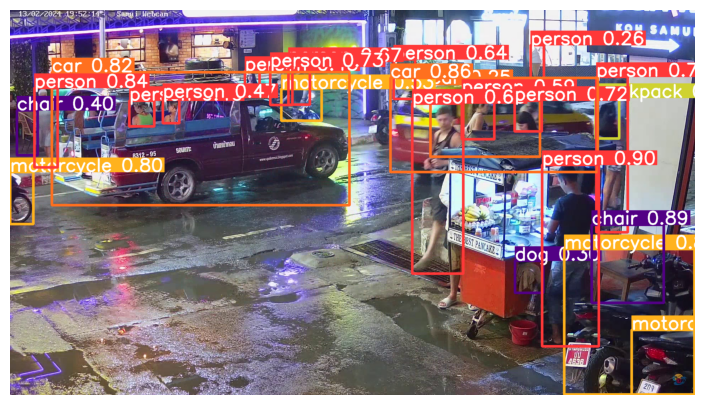

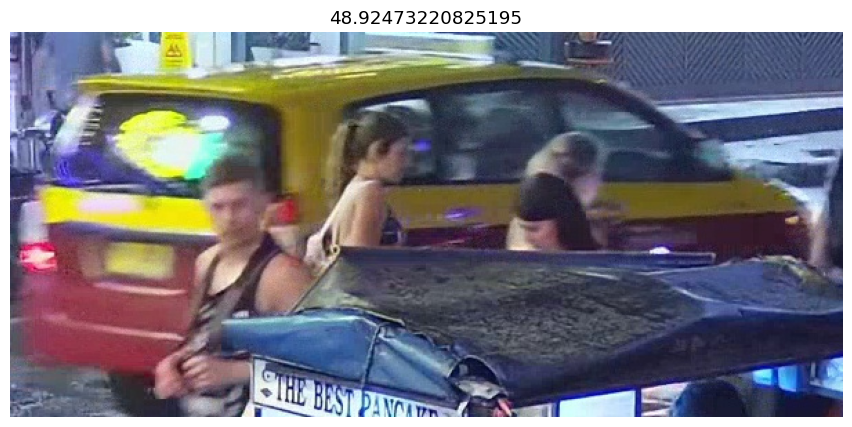

Saved 1 image to YOLO\frame_6602
Saved results to YOLO\frame_6602



43.8622932434082
43.10129165649414
42.92714881896973
41.0308952331543
40.840171813964844


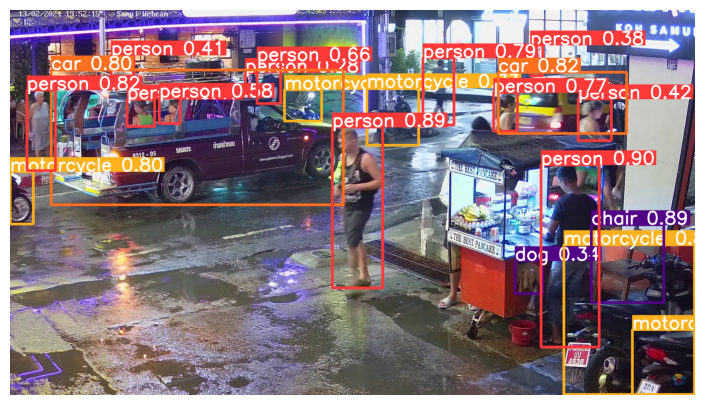

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_7202
Saved results to YOLO\frame_7202



43.61166954040527
41.92572784423828
41.534422874450684
41.486318588256836
41.36376953125


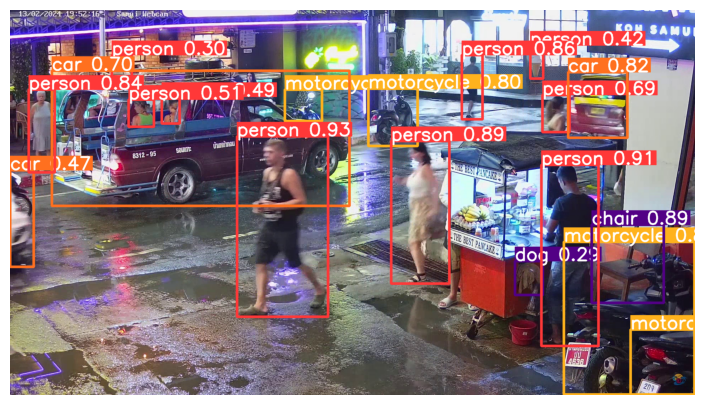

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_7802
Saved results to YOLO\frame_7802



44.80524253845215
42.84580039978027
40.747371673583984
40.70623207092285
40.65630912780762


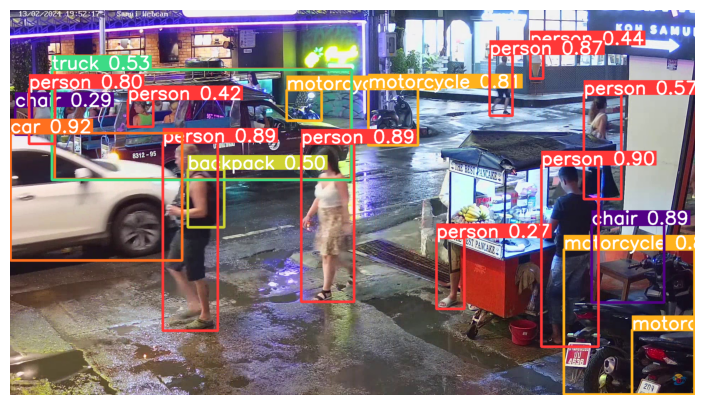

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_8402
Saved results to YOLO\frame_8402



43.78859329223633
43.58779525756836
43.0135612487793
41.87989044189453
41.44198417663574


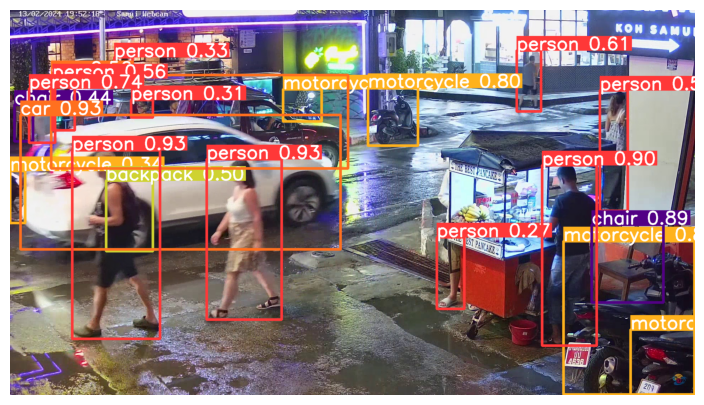

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_9002
Saved results to YOLO\frame_9002



44.47241401672363
43.166133880615234
42.15291786193848
42.0218448638916
42.00166702270508


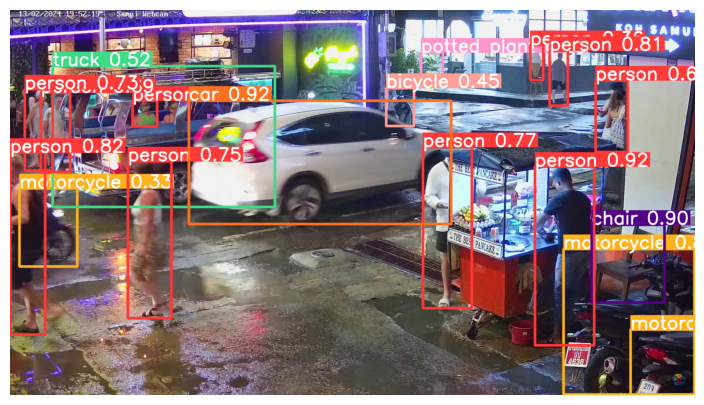

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_9602
Saved results to YOLO\frame_9602



49.619951248168945
44.5563850402832
42.97066879272461
42.72393035888672
42.37215805053711


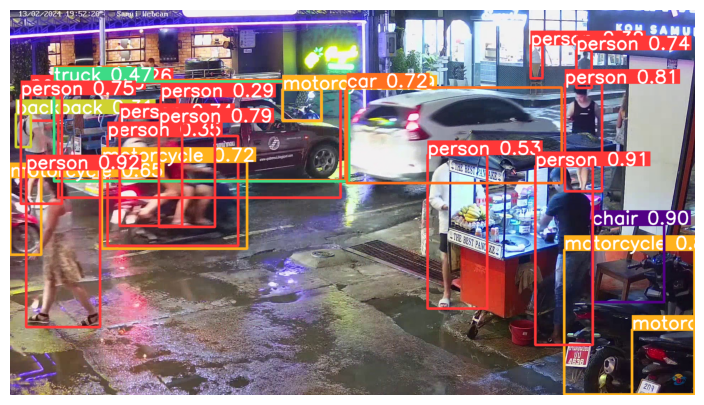

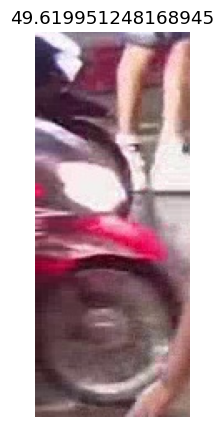

Saved 1 image to YOLO\frame_10202
Saved results to YOLO\frame_10202



45.10224533081055
45.006093978881836
44.366119384765625
42.376014709472656
42.26562309265137


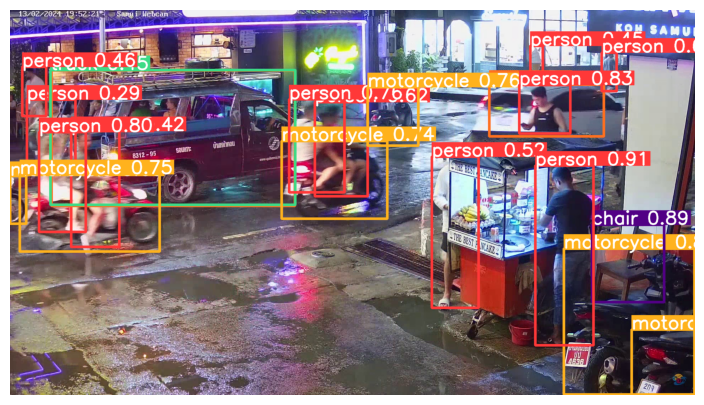

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_10802
Saved results to YOLO\frame_10802



45.358707427978516
43.743635177612305
43.58261489868164
42.46863555908203
42.4591007232666


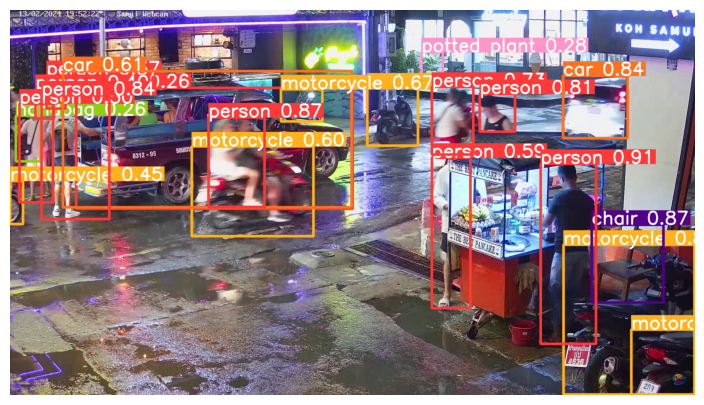

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_11402
Saved results to YOLO\frame_11402



46.60574150085449
43.885149002075195
43.628713607788086
42.668392181396484
42.345760345458984


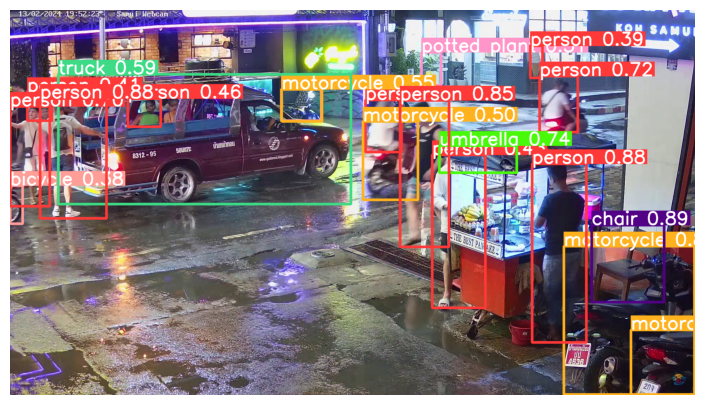

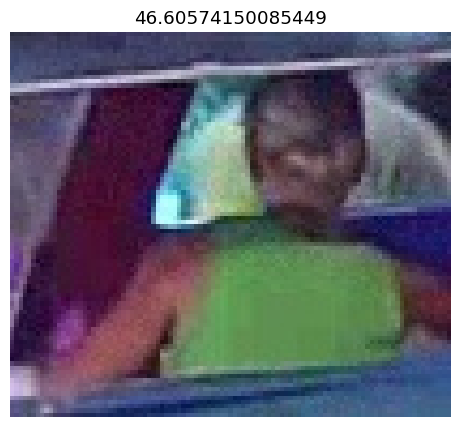

Saved 1 image to YOLO\frame_12002
Saved results to YOLO\frame_12002



45.79780960083008
44.532785415649414
43.797607421875
42.89272499084473
42.148088455200195


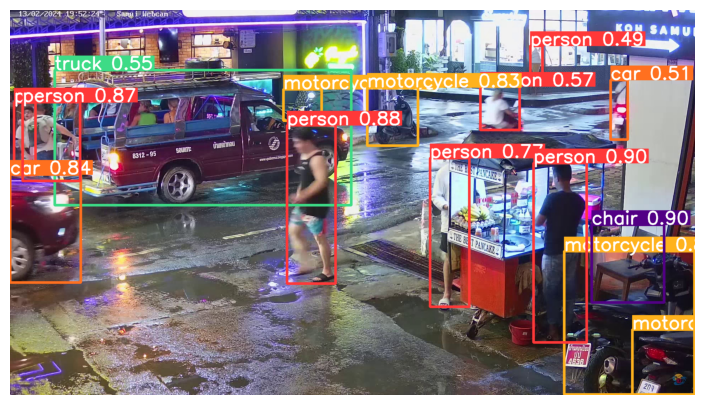

<Figure size 2000x500 with 0 Axes>

In [48]:
pipeline("footage2.mp4","red","yellow car")

Saved 1 image to YOLO\frame_0
Saved results to YOLO\frame_0



52.1900691986084
48.622392654418945
48.372093200683594
47.86668586730957
47.07754898071289


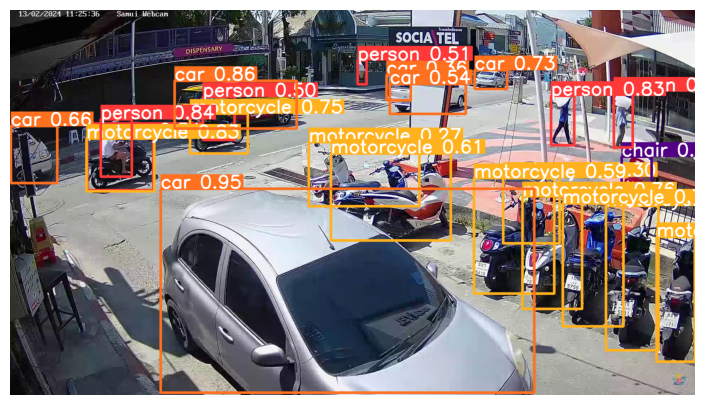

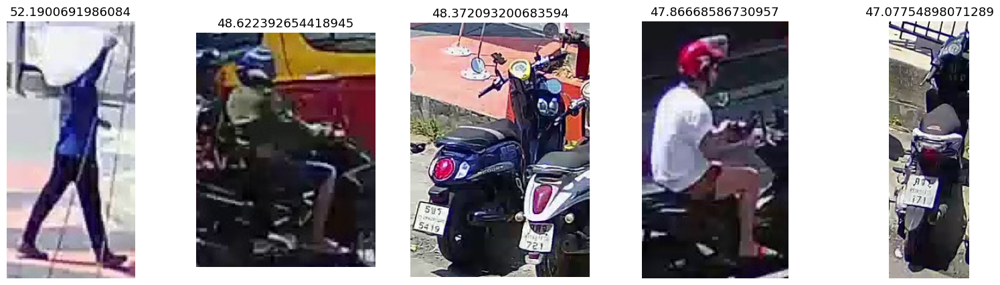

Saved 1 image to YOLO\frame_60
Saved results to YOLO\frame_60



47.43365287780762
46.26597595214844
45.251869201660156
43.667165756225586
43.360761642456055


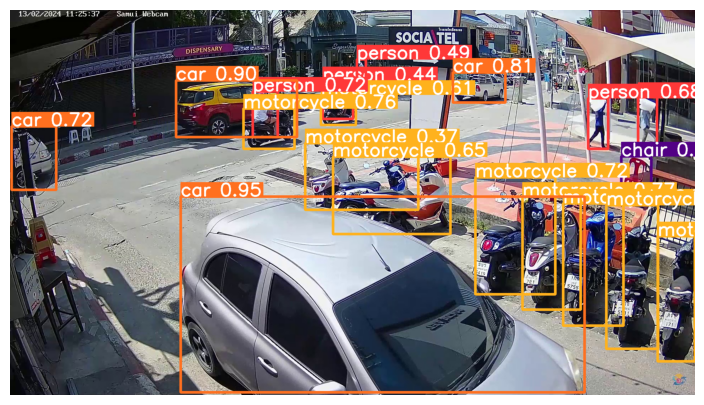

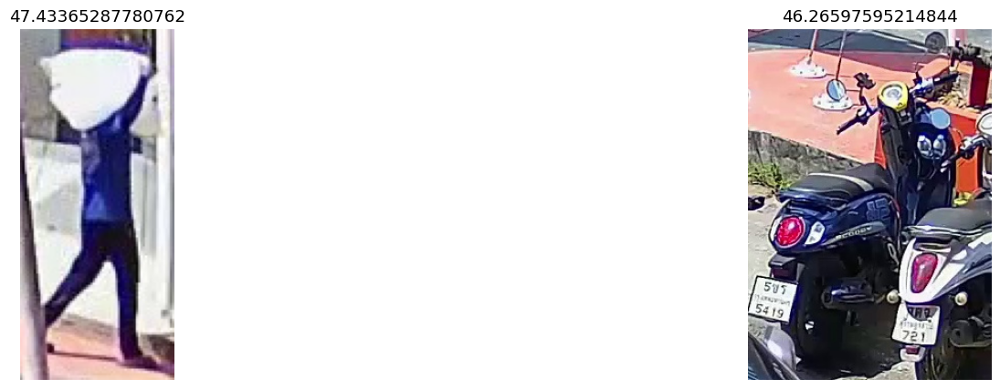

Saved 1 image to YOLO\frame_120
Saved results to YOLO\frame_120



48.9266414642334
47.42615509033203
45.13168716430664
44.783958435058594
44.70002746582031


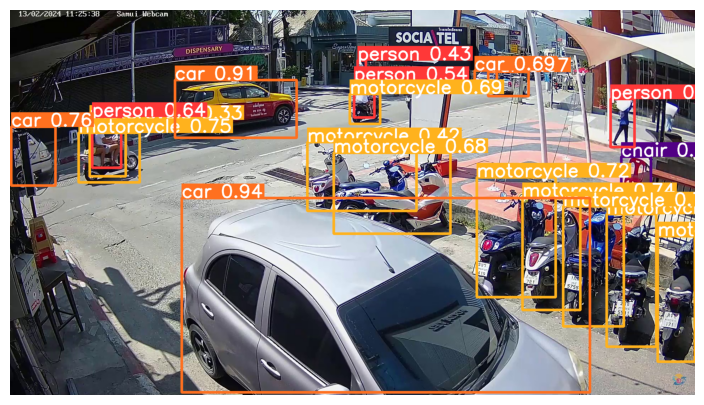

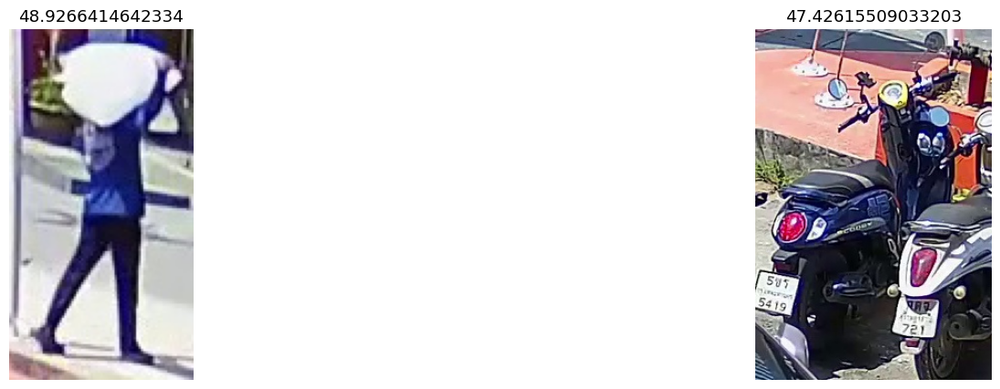

Saved 1 image to YOLO\frame_180
Saved results to YOLO\frame_180



49.16372108459473
46.96199607849121
44.42079162597656
43.49466323852539
43.41670227050781


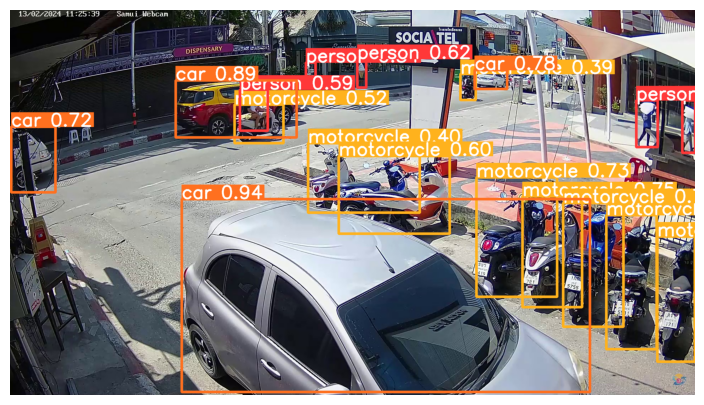

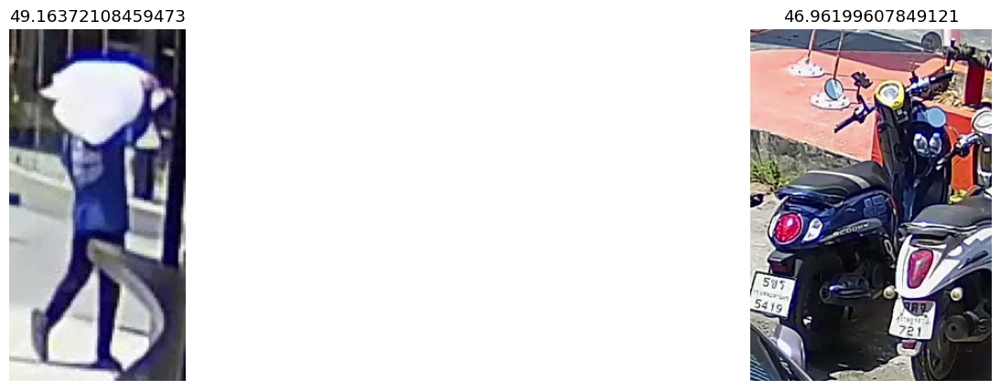

Saved 1 image to YOLO\frame_240
Saved results to YOLO\frame_240



45.35836219787598
44.829349517822266
44.59426498413086
44.2070198059082
43.76435089111328


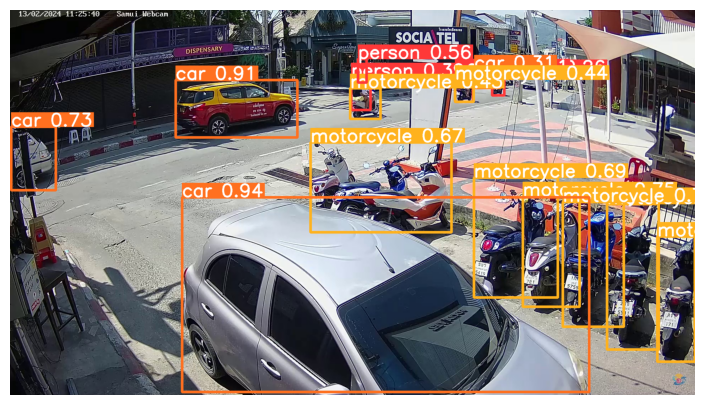

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_300
Saved results to YOLO\frame_300



46.1179313659668
45.0355339050293
44.79485893249512
44.60736846923828
42.822021484375


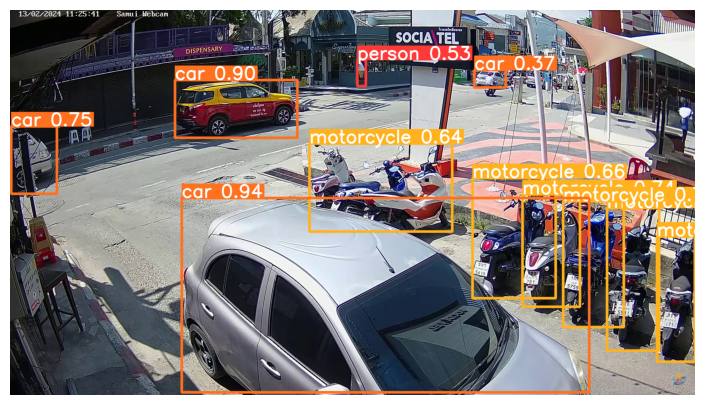

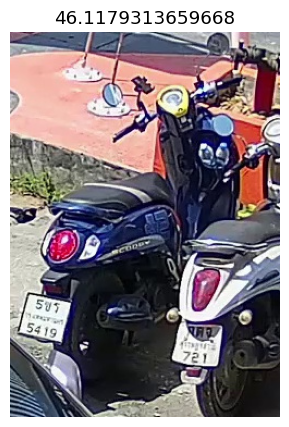

Saved 1 image to YOLO\frame_360
Saved results to YOLO\frame_360



45.84243583679199
44.753746032714844
44.23928260803223
43.96442413330078
42.82738494873047


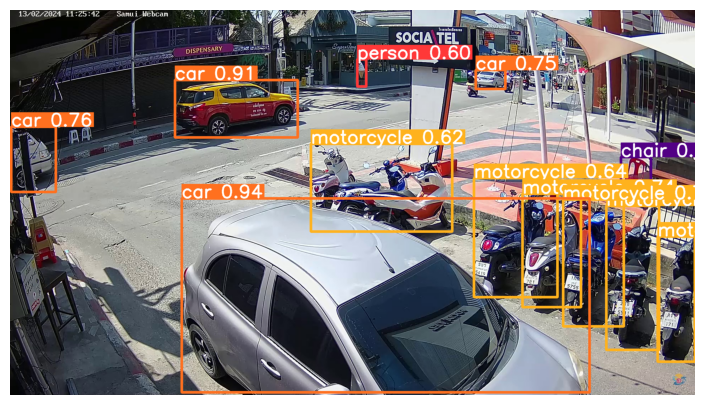

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_420
Saved results to YOLO\frame_420



45.483224868774414
44.55027961730957
43.951772689819336
43.69056701660156
43.38726043701172


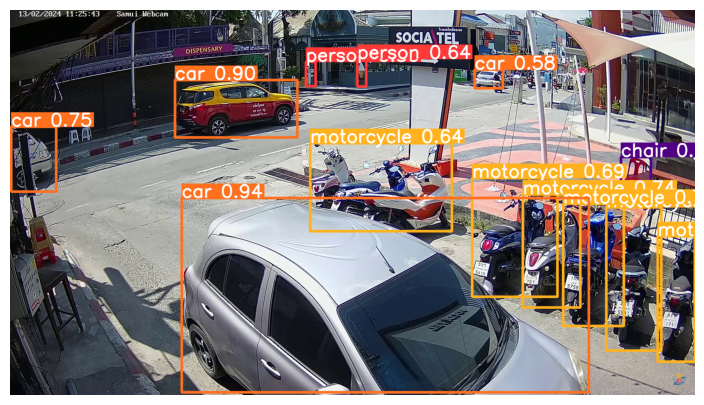

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_480
Saved results to YOLO\frame_480



45.33310508728027
44.25631523132324
43.95763969421387
43.47512626647949
42.43772506713867


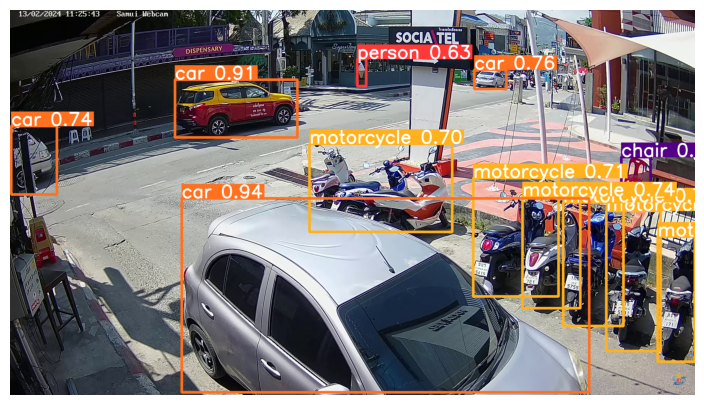

<Figure size 2000x500 with 0 Axes>

Saved 1 image to YOLO\frame_540
Saved results to YOLO\frame_540



45.5526237487793
44.31106948852539
43.99289321899414
43.90281867980957
43.27559471130371


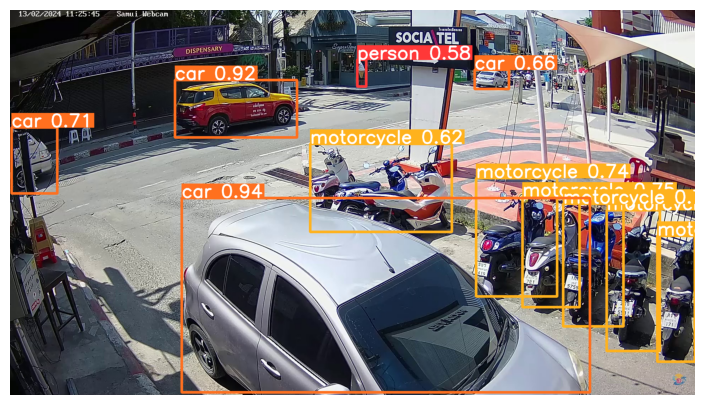

<Figure size 2000x500 with 0 Axes>

In [51]:
pipeline("FootageSample.mp4","man","blue clothes")